# **Start**

In [1]:
!pip uninstall -y scikit-learn
!pip install scikit-learn==1.5.2
!pip install bayesian-optimization
!pip install optuna
!pip install catboost
!pip install gpboost
!pip install shap
!pip install ngboost
!pip install dask[dataframe]
!pip install torch seaborn
!pip install lightgbm
!pip install xgboost
!pip install lime
!pip install interpret
!pip install optunahub
!pip install cmaes
!pip install ipywidgets
!pip install hyperopt

Found existing installation: scikit-learn 1.6.1
Uninstalling scikit-learn-1.6.1:
  Successfully uninstalled scikit-learn-1.6.1
  Using cached scikit_learn-1.5.2-cp312-cp312-win_amd64.whl.metadata (13 kB)
Using cached scikit_learn-1.5.2-cp312-cp312-win_amd64.whl (11.0 MB)


ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
ngboost 0.5.5 requires scikit-learn<2.0,>=1.6, but you have scikit-learn 1.5.2 which is incompatible.


  Using cached scikit_learn-1.6.1-cp312-cp312-win_amd64.whl.metadata (15 kB)
Using cached scikit_learn-1.6.1-cp312-cp312-win_amd64.whl (11.1 MB)
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.5.2
    Uninstalling scikit-learn-1.5.2:
      Successfully uninstalled scikit-learn-1.5.2


In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import randint
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error,make_scorer
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor
from gpboost import GPBoostRegressor
from ngboost import NGBRegressor
from bayes_opt import BayesianOptimization
import optuna
from hyperopt import fmin, tpe, hp, Trials, STATUS_OK, space_eval
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingGridSearchCV
from lime.lime_tabular import LimeTabularExplainer
import shap
from interpret import show
from interpret.blackbox import LimeTabular
from sklearn.ensemble import AdaBoostRegressor
import warnings
warnings.filterwarnings('ignore')

In [5]:
train_data_path =  r"C:\Users\dell\Desktop\datascience\projects\train1.csv"
test_data_path =  r"C:\Users\dell\Desktop\datascience\projects\test1.csv"

In [7]:
train_data = pd.read_csv(train_data_path)
test_data = pd.read_csv(test_data_path)
print("Training data loaded successfully.")
print("Test data loaded successfully.")

Training data loaded successfully.
Test data loaded successfully.


In [9]:
print("\nShape of training data:", train_data.shape)
print("First 10 rows of training data:\n", train_data.head(5))
print("\nShape of test data:", test_data.shape)
print("First 10 rows of test data:\n", test_data.head(5))


Shape of training data: (47, 15)
First 10 rows of training data:
      pH   TDS    EC    TH   ca    mg  CO3  HCO3   NA    K  CHLORIDE  SULPHATE  \
0  7.90   552   865   452  272   180  0.2   4.5  260   44       375       681   
1  7.52  1985  2256  1054  529   525  0.0  15.0  272   47       728       324   
2  7.65  1865  2032   636  371   265  0.0   9.0  373   25       713       503   
3  7.25  4855  7856  2050  795  1255  0.0  12.5  335  106        81       676   
4  7.96  2855  3696   865  310   555  0.3   4.6  184  106       698       324   

   NITRATE  FLUORIDE  Pre monsoon EWQI   
0       60      0.40              70.52  
1       10      0.65             138.78  
2       54      0.85             113.07  
3       17      0.69             266.32  
4       25      1.20             158.05  

Shape of test data: (47, 15)
First 10 rows of test data:
      pH   TDS    EC    TH     ca      mg  CO3  HCO3   NA    K  CHLORIDE  \
0  8.38   625   975   320  120.0   200.0  0.0   5.8  280   3

In [11]:
X_train = train_data.iloc[:, :-1]
y_train = train_data.iloc[:, -1]
X_test = test_data.iloc[:, :-1]
y_test = test_data.iloc[:, -1]
x_test= X_test
print("\nShape of X_train:", X_train.shape)
print("Shape of y_train:", y_train.shape)
print("Shape of X_test:", X_test.shape)
print("Shape of y_test:", y_test.shape)


Shape of X_train: (47, 14)
Shape of y_train: (47,)
Shape of X_test: (47, 14)
Shape of y_test: (47,)


In [13]:
# Apply z-score normalization
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Print the first five rows of the normalized data
print("\nFirst five rows of normalized X_train:")
print(X_train[:5])

print("\nFirst five rows of normalized X_test:")
print(X_test[:5])


First five rows of normalized X_train:
[[ 0.3797749  -1.15230942 -0.94309903 -0.47923131 -0.09229732 -0.56852482
  -0.03922784 -1.18768739 -0.02713192 -0.87884263 -0.2770724   1.15873613
   1.41276153 -1.25316406]
 [-0.78765707 -0.2953837  -0.52059702  0.45803078  1.31357822  0.10564733
  -0.50015494  1.61405127  0.07159325 -0.77136925  1.29937074 -0.45273785
  -1.61366471 -0.53733141]
 [-0.38827245 -0.36714301 -0.58863473 -0.19275917  0.44926563 -0.40242444
  -0.50015494  0.01305775  0.90253007 -1.55950739  1.23238307  0.35525611
   1.04959038  0.03533472]
 [-1.61714822  1.42085972  1.18034563  2.00871688  2.76868675  1.53215652
  -0.50015494  0.94697063  0.58990037  1.34227396 -1.59003071  1.13616647
  -1.18996504 -0.42279818]
 [ 0.56410627  0.22487128 -0.08321177  0.16377408  0.11557533  0.16427099
   0.19123571 -1.16100417 -0.6523913   1.34227396  1.1653954  -0.45273785
  -0.70573684  1.03750043]]

First five rows of normalized X_test:
[[ 1.85442582 -1.10865585 -0.90968766 -0.6847

In [17]:
# Define the model classes
model_classes = {
    'Linear Regression': LinearRegression,
    'Decision Tree': DecisionTreeRegressor,
    'Random Forest': RandomForestRegressor,
    'Gradient Boosting': GradientBoostingRegressor,
    'XGBoost': XGBRegressor,
    'LightGBM': LGBMRegressor,
    'GPBoost': GPBoostRegressor,
    'CatBoost': CatBoostRegressor,
    'SVM': SVR,
    'NGBoost': NGBRegressor
}

feature_names =  ['pH', 'TDS', 'EC', 'TH', 'Ca', 'Mg','CO3 ','HCO3','NA ', 'K', 'CHLORIDE','SULPHATE','NITRATE','FLUORIDE']

# Function to predict and save data.
def predict_and_save_results(results_dict, X_train, y_train, X_test, output_file_path):

    predictions_df = pd.read_csv(output_file_path)

    for model_name, model_info in results_dict.items():
        best_params = model_info['best_params']
        model_class = model_classes.get(model_name)

        if model_class is None:
            print(f"Model {model_name} is not supported or not available.")
            continue

        # Special handling for CatBoost to suppress verbose output
        if model_name == 'CatBoost':
            model = model_class(**best_params, verbose=0)
        else:
            model = model_class(**best_params)

        # Fit the model
        model.fit(X_train, y_train)

        # Make predictions
        predictions = model.predict(X_test)

        # Add predictions to DataFrame
        predictions_df[f'Sd_{model_name}'] = np.round(predictions, 2)

    # Save predictions to a CSV file at the specified location
    predictions_df.to_csv(output_file_path, index=False)
    print("Predictions have been added to the CSV file.")

# **LIME and SHAP**

In [20]:
def generate_explanations(results_dict, X_train, y_train, X_test, feature_names, method='shap', instance_idx=0):
    """
    Generate SHAP and/or LIME explanations for a specified instance.

    Parameters:
    - results_dict: Dictionary containing model information and best parameters.
    - X_train: Training data features (numpy array or pandas DataFrame).
    - y_train: Training data labels.
    - X_test: Test data features (numpy array or pandas DataFrame).
    - feature_names: List of feature names.
    - method: 'shap', 'lime', or 'both'. Determines which explanation method(s) to use.
    - instance_idx: Index of the instance to explain (default is 0).
    """
    # Ensure feature_names is a list
    if isinstance(feature_names, np.ndarray):
        feature_names = feature_names.tolist()

    for model_name, model_info in results_dict.items():
        best_params = model_info['best_params']
        model_class = model_classes.get(model_name)

        if model_class is None:
            print(f"Model {model_name} is not supported or not available.")
            continue

        model = model_class(**best_params)

        # Fit the model
        model.fit(X_train, y_train)

        # Ensure the instance index is within the bounds of X_test
        if instance_idx < 0 or instance_idx >= len(X_test):
            print(f"Instance index {instance_idx} is out of bounds. Please provide a valid index.")
            continue

        # Generate explanations based on the selected method(s)
        if method.lower() == 'shap' or method.lower() == 'both':
            # For SHAP, instance as 2D array
            if isinstance(X_test, pd.DataFrame):
                instance = X_test.iloc[instance_idx:instance_idx+1]
            else:
                instance = X_test[instance_idx:instance_idx+1]

            # Determine the appropriate explainer
            if model_name in ["XGBoost", "LightGBM", "CatBoost"]:
                explainer = shap.TreeExplainer(model)
            else:
                explainer = shap.KernelExplainer(model.predict, X_train)

            # Generate SHAP values for the chosen instance
            shap_values = explainer.shap_values(instance)

            # Print the explanation
            print(f"\nSHAP Explanation for instance {instance_idx} in {model_name}:")

            shap.initjs()  # To render plots interactively if using Jupyter Notebook

            # For regression, shap_values is an array
            # Use a force plot to visualize the SHAP values for the single prediction
            shap.force_plot(explainer.expected_value, shap_values, instance, feature_names=feature_names, matplotlib=True)
            plt.show()

            # Optionally, generate a summary plot for multiple instances
            shap_values_complete = explainer.shap_values(X_test)
            shap.summary_plot(shap_values_complete, X_test, feature_names=feature_names)

        if method.lower() == 'lime' or method.lower() == 'both':
            # For LIME, instance as 1D array
            if isinstance(X_test, pd.DataFrame):
                instance = X_test.iloc[instance_idx]
            else:
                instance = X_test[instance_idx]

            # Create a LIME explainer with actual feature names
            explainer = LimeTabularExplainer(
                X_train,  # This is the training data
                feature_names=feature_names,
                discretize_continuous=True,
                mode='regression'
            )

            # Generate explanation for the chosen instance
            exp = explainer.explain_instance(instance, model.predict, num_features=len(feature_names))

            # Print the explanation
            print(f"\nLIME Explanation for instance {instance_idx} in {model_name}:")

            # Show the explanation in a Jupyter Notebook
            exp.show_in_notebook(show_table=True, show_all=False)

            # Alternatively, plot the explanation using matplotlib
            fig = exp.as_pyplot_figure()
            plt.title(f"LIME Explanation for {model_name}")
            plt.show()

# **InterpretML with absolute values output**

In [23]:

def generate_interpretml_explanations_summary(results_dict, X_train, y_train, X_test, feature_names, instance_indices=None):
    """
    Generate a summary of InterpretML explanations for specified instances.

    Parameters:
    - results_dict: Dictionary containing model information and best parameters.
    - X_train: Training data features.
    - y_train: Training data labels.
    - X_test: Test data features.
    - feature_names: List of feature names.
    - instance_indices: List of indices of the instances to explain.
                        If None, explanations will be generated for all instances in X_test.
    """
    if instance_indices is None:
        # If no indices specified, explain all instances in X_test
        instance_indices = range(len(X_test))
    elif isinstance(instance_indices, int):
        # If a single integer is provided, make it a list
        instance_indices = [instance_indices]

    # Validate indices and collect the instances to explain
    valid_indices = []
    for idx in instance_indices:
        if 0 <= idx < len(X_test):
            valid_indices.append(idx)
        else:
            print(f"Instance index {idx} is out of bounds. Skipping.")

    if not valid_indices:
        print("No valid instance indices provided.")
        return

    # Corrected line: Use .iloc to select rows by index
    instances_to_explain = X_test.iloc[valid_indices]

    for model_name, model_info in results_dict.items():
        best_params = model_info['best_params']
        model_class = model_classes.get(model_name)

        if model_class is None:
            print(f"Model {model_name} is not supported or not available.")
            continue

        # Suppress CatBoost output if the model is CatBoost
        if model_name == 'CatBoost':
            best_params['verbose'] = 0  # Suppress output by setting verbose to 0
            # If 'verbose' is already in best_params, it will be overwritten

        # Instantiate the model with best parameters
        model = model_class(**best_params)

        # Fit the model
        model.fit(X_train, y_train)

        # Define a predict function for the explainer
        def predict_fn(data):
            return model.predict(data)

        # Use LimeTabular from InterpretML with the model's predict method
        lime_explainer = LimeTabular(
            predict_fn,
            data=X_train,
            feature_names=feature_names,
            random_state=1,
            mode='regression'
        )

        # Generate the explanations for all selected instances
        lime_explanation = lime_explainer.explain_local(instances_to_explain)

        # Aggregate feature importances
        feature_importances = {}
        num_instances = len(valid_indices)

        # Iterate over explanations for each instance
        for idx in range(num_instances):
            explanation = lime_explanation.data(idx)
            # Using 'names' and 'scores' directly
            for feature_name, feature_score in zip(explanation['names'], explanation['scores']):
                if feature_name in feature_importances:
                    feature_importances[feature_name] += abs(feature_score)
                else:
                    feature_importances[feature_name] = abs(feature_score)

        # Average the importance scores
        for feature in feature_importances:
            feature_importances[feature] /= num_instances

        # Round the importance scores to 3 decimal places to prevent overlapping text
        for feature in feature_importances:
            feature_importances[feature] = round(feature_importances[feature], 3)

        # Create a DataFrame for plotting
        feature_importances_df = pd.DataFrame.from_dict(feature_importances, orient='index', columns=['importance'])
        feature_importances_df.sort_values(by='importance', ascending=False, inplace=True)

        # Plot the aggregated feature importances
        plt.figure(figsize=(10, 6))
        ax = feature_importances_df.plot(kind='bar', legend=False)
        plt.title(f"Aggregated Feature Importances for {model_name}")
        plt.ylabel("Average Absolute Importance Score")
        plt.xlabel("Features")
        plt.xticks(rotation=45, ha='right')

        # Annotate bars with importance values
        for p in ax.patches:
            height = p.get_height()
            ax.annotate(f'{height:.3f}', (p.get_x() + p.get_width() / 2., height),
                        ha='center', va='bottom', fontsize=8, rotation=0)

        plt.tight_layout()
        plt.show()

# **Interpret for all instances**

In [26]:
def generate_interpretml_explanations_all(results_dict, X_train, y_train, X_test, feature_names):
    """
    Generate a summary of InterpretML explanations for specified instances.

    Parameters:
    - results_dict: Dictionary containing model information and best parameters.
    - X_train: Training data features.
    - y_train: Training data labels.
    - X_test: Test data features.
    - feature_names: List of feature names.
    - instance_indices: List of indices of the instances to explain.
                        If None, explanations will be generated for all instances in X_test.
    """

    instances_to_explain = X_test

    for model_name, model_info in results_dict.items():
        best_params = model_info['best_params']
        model_class = model_classes.get(model_name)

        if model_class is None:
            print(f"Model {model_name} is not supported or not available.")
            continue

        # Suppress CatBoost output if the model is CatBoost
        if model_name == 'CatBoost':
            best_params['verbose'] = 0  # Suppress output by setting verbose to 0
            # If 'verbose' is already in best_params, it will be overwritten

        # Instantiate the model with best parameters
        model = model_class(**best_params)

        # Fit the model
        model.fit(X_train, y_train)

         # Print model and explainer names before the graph
        explainer_name = 'LIME'
        print(f"Model: {model_name}")
        print(f"Explainer: {explainer_name}")

        # Define a predict function for the explainer
        def predict_fn(data):
            return model.predict(data)

        lime = LimeTabular(
            predict_fn,
            data=X_train,
            feature_names=feature_names,
            random_state=1,
            mode='regression'
        )

        # Get local explanations
        lime_local = lime.explain_local(X_test,
                                y_test,
                                name='LIME')

        show(lime_local)

# **Optuna**

In [29]:
# Suppress Optuna's verbose output
optuna.logging.set_verbosity(optuna.logging.WARNING)

def hyperparameter_tuning_optuna(X_train, y_train, X_test, y_test):
    def objective(trial, model_name, model_class, param_space):
        # Suggest hyperparameters
        params = {key: trial.suggest_categorical(key, values) if isinstance(values, list) else trial.suggest_float(key, *values) for key, values in param_space.items()}

        # Create a new instance of the model
        model = model_class()
        model.set_params(**params)

        # Ensure the input arrays are writable
        X_train_copy = np.array(X_train, copy=True)
        y_train_copy = np.array(y_train, copy=True)
        X_test_copy = np.array(X_test, copy=True)
        y_test_copy = np.array(y_test, copy=True)

        # Train model
        model.fit(X_train_copy, y_train_copy)

        # Predict
        y_pred = model.predict(X_test_copy)

        # Calculate MSE
        mse = mean_squared_error(y_test_copy, y_pred)

        return mse

    models = {
        'Linear Regression': (LinearRegression, {
            'fit_intercept': [True, False],
            'copy_X': [True, False],
            'n_jobs': [-1, None],
            'positive': [True, False]
        }),
        'Decision Tree': (DecisionTreeRegressor, {
            'max_depth': [None, 5, 10, 15],
            'min_samples_split': [2, 5, 10],
            'min_samples_leaf': [1, 2, 4],
            'max_features': ['sqrt', 'log2', None]
        }),
        'Random Forest': (RandomForestRegressor, {
            'n_estimators': [100, 200, 500],
            'max_depth': [None, 5, 10, 15],
            'min_samples_split': [2, 5, 10],
            'min_samples_leaf': [1, 2, 4],
            'max_features': ['sqrt', 'log2', None]
        }),
        'Gradient Boosting': (GradientBoostingRegressor, {
            'n_estimators': [100, 200, 500],
            'learning_rate': [0.01, 0.05, 0.1],
            'max_depth': [3, 5, 10],
            'min_samples_split': [2, 5, 10],
            'min_samples_leaf': [1, 2, 4],
            'max_features': ['sqrt', 'log2']
        }),
        'XGBoost': (XGBRegressor, {
            'learning_rate': [0.01, 0.05, 0.1],
            'max_depth': [3, 5, 7],
            'n_estimators': [100, 200, 300, 500],
            'min_child_weight': [1, 3, 5],
            'gamma': [0, 0.1, 0.5, 1],
            'subsample': [0.5, 0.7, 0.9],
            'colsample_bytree': [0.5, 0.7, 0.9]
        }),
        'LightGBM': (LGBMRegressor, {
            'learning_rate': [0.01, 0.05, 0.1],
            'max_depth': [3, 5, 7],
            'n_estimators': [100, 200, 300, 500],
            'num_leaves': [15, 31, 63],
            'min_child_samples': [1, 5, 10],
            'subsample': [0.5, 0.7, 0.9],
            'colsample_bytree': [0.5, 0.7, 0.9]
        }),
        'GPBoost': (GPBoostRegressor, {
            'learning_rate': [0.01, 0.05, 0.1],
            'max_depth': [3, 5, 7],
            'n_estimators': [100, 200, 300, 500],
            'num_leaves': [15, 31, 63],
            'min_child_samples': [1, 5, 10],
            'subsample': [0.5, 0.7, 0.9],
            'colsample_bytree': [0.5, 0.7, 0.9],
            'alpha': [0.1, 0.5, 1.0],
            'lambda': [0.1, 0.5, 1.0]
        }),
        'CatBoost': (CatBoostRegressor, {
            'learning_rate': [0.01, 0.05, 0.1],
            'iterations': [100, 200, 300, 500],
            'depth': [3, 5, 7],
            'l2_leaf_reg': [1, 3, 5],
            'border_count': [32, 64, 128]
        }),
        'SVM': (SVR, {
            'kernel': ['linear', 'rbf', 'poly'],
            'C': [0.1, 1, 10],
            'gamma': [0.01, 0.1, 1],
            'degree': [2, 3, 4],
            'epsilon': [0.01, 0.1, 1]
        }),
        'NGBoost': (NGBRegressor, {
            'n_estimators': [100, 200],
            'learning_rate': [0.01, 0.1],
            'natural_gradient': [True, False],
            'minibatch_frac': [0.5, 0.7]
        })
    }

    best_scores = {}
    for model_name, (model_class, param_space) in models.items():
        print(f"Running Optuna for {model_name}...")
        try:
            study = optuna.create_study(direction='minimize')
            study.optimize(lambda trial: objective(trial, model_name, model_class, param_space), n_trials=50)

            best_params = study.best_params
            best_model = model_class().set_params(**best_params)
            best_model.fit(X_train, y_train)
            y_pred = best_model.predict(X_test)

            # Calculate MSE
            mse = mean_squared_error(y_test, y_pred)

            # Calculate RMSE
            rmse = np.sqrt(mse)

            # Calculate correlation coefficient
            numerator = np.sum((y_test - np.mean(y_test)) * (y_pred - np.mean(y_pred)))
            denominator = np.sqrt(np.sum((y_test - np.mean(y_test))**2) * np.sum((y_pred - np.mean(y_pred))**2))
            corr_coef = numerator / denominator if denominator != 0 else 0.0

            best_scores[model_name] = {
                'best_score': mse,
                'best_params': best_params,
                'test_mse': mse,
                'test_rmse': rmse,
                'test_corr_coef': corr_coef
            }
            print(f"Best MSE for {model_name}: {mse} with params: {best_params}")
            print(f"Best RMSE for {model_name}: {rmse}")
            print(f"Correlation Coefficient for {model_name}: {corr_coef}")
        except Exception as e:
            print(f"Failed to run Optuna for {model_name}. Error: {e}")

    # Find the model with the best test score
    if best_scores:
        best_model_name = min(best_scores, key=lambda k: best_scores[k]['test_mse'])
        best_model_info = best_scores[best_model_name]
        print(f"\nBest model on test data: {best_model_name}")
        print(f"Test MSE: {best_model_info['test_mse']}")
        print(f"Test RMSE: {best_model_info['test_rmse']}")
        print(f"Correlation Coefficient: {best_model_info['test_corr_coef']}")
        print(f"Best Parameters: {best_model_info['best_params']}")
    else:
        print("No valid model configurations found.")

    return best_scores

best_scores_ran = hyperparameter_tuning_optuna(X_train, y_train, X_test, y_test)

Running Optuna for Linear Regression...


[W 2025-04-01 20:02:25,502] Trial 4 failed with parameters: {'fit_intercept': False, 'copy_X': True, 'n_jobs': -1, 'positive': True} because of the following error: RuntimeError('Maximum number of iterations reached.').
Traceback (most recent call last):
  File "C:\Users\dell\anaconda3\Lib\site-packages\optuna\study\_optimize.py", line 197, in _run_trial
    value_or_values = func(trial)
                      ^^^^^^^^^^^
  File "C:\Users\dell\AppData\Local\Temp\ipykernel_7728\3751050144.py", line 114, in <lambda>
    study.optimize(lambda trial: objective(trial, model_name, model_class, param_space), n_trials=50)
                                 ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\dell\AppData\Local\Temp\ipykernel_7728\3751050144.py", line 20, in objective
    model.fit(X_train_copy, y_train_copy)
  File "C:\Users\dell\anaconda3\Lib\site-packages\sklearn\base.py", line 1389, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^

Failed to run Optuna for Linear Regression. Error: Maximum number of iterations reached.
Running Optuna for Decision Tree...
Best MSE for Decision Tree: 660.5556825273693 with params: {'max_depth': 5, 'min_samples_split': 5, 'min_samples_leaf': 2, 'max_features': 'sqrt'}
Best RMSE for Decision Tree: 25.701277838414363
Correlation Coefficient for Decision Tree: 0.9211482338116431
Running Optuna for Random Forest...
Best MSE for Random Forest: 492.38563091773665 with params: {'n_estimators': 200, 'max_depth': 10, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': None}
Best RMSE for Random Forest: 22.189764102345404
Correlation Coefficient for Random Forest: 0.954951421375283
Running Optuna for Gradient Boosting...
Best MSE for Gradient Boosting: 409.23965548428197 with params: {'n_estimators': 200, 'learning_rate': 0.1, 'max_depth': 5, 'min_samples_split': 10, 'min_samples_leaf': 1, 'max_features': 'log2'}
Best RMSE for Gradient Boosting: 20.229672648964986
Correlation Coeff

# **Explainations**


LIME Explanation for instance 5 in Decision Tree:


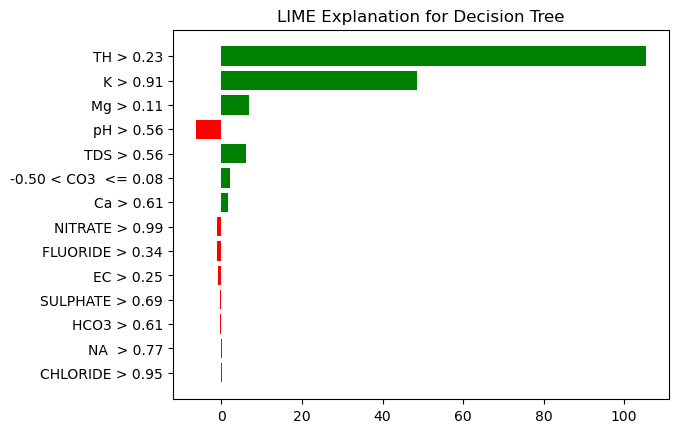


LIME Explanation for instance 5 in Random Forest:


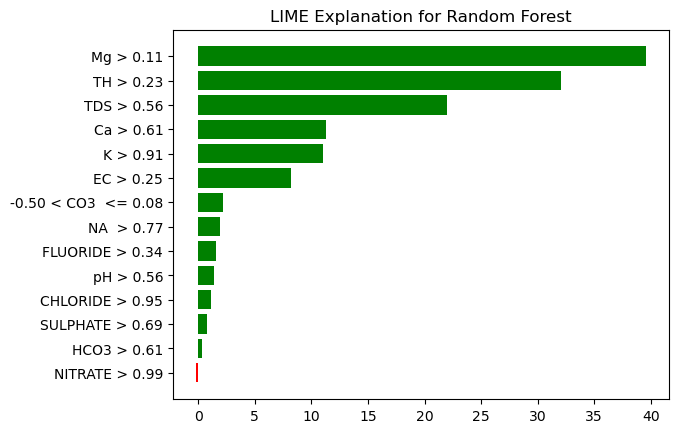


LIME Explanation for instance 5 in Gradient Boosting:


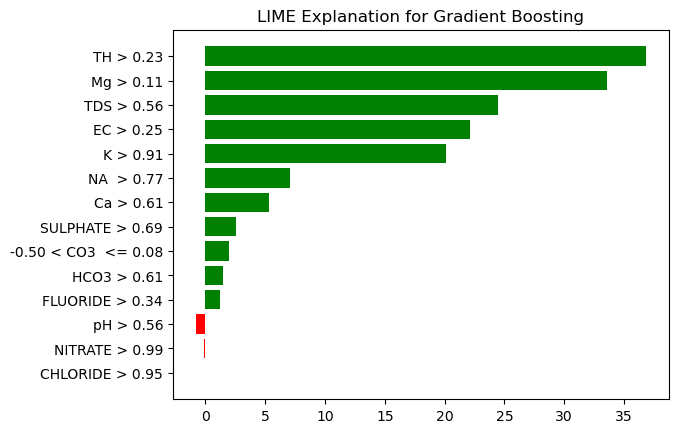


LIME Explanation for instance 5 in XGBoost:


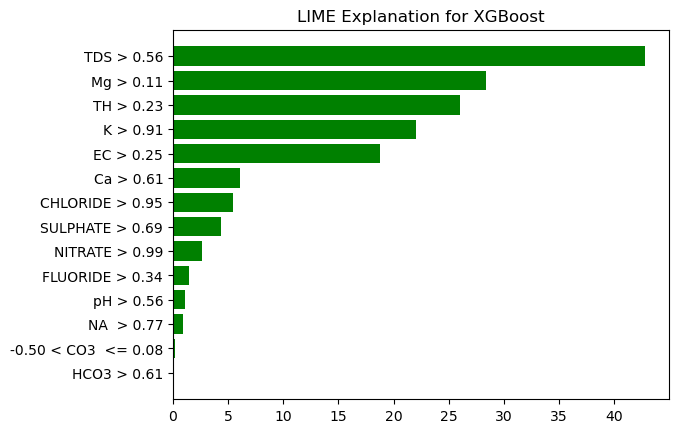

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000575 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 216
[LightGBM] [Info] Number of data points in the train set: 47, number of used features: 14
[LightGBM] [Info] Start training from score 128.566383
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

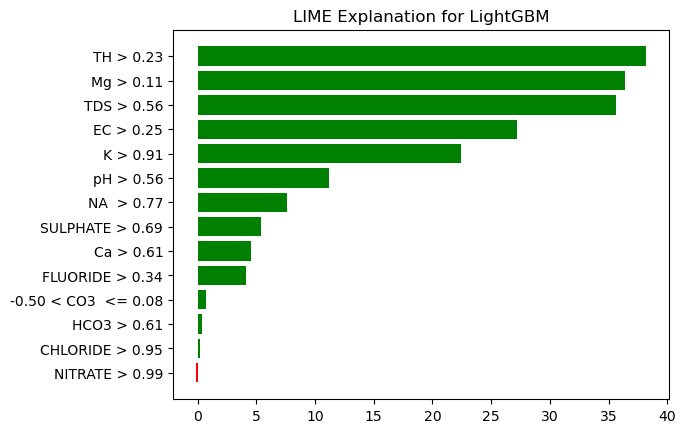

[GPBoost] [Warning] lambda_l2 is set with reg_lambda=0.0, will be overridden by lambda=0.5. Current value: lambda_l2=0.5

LIME Explanation for instance 5 in GPBoost:


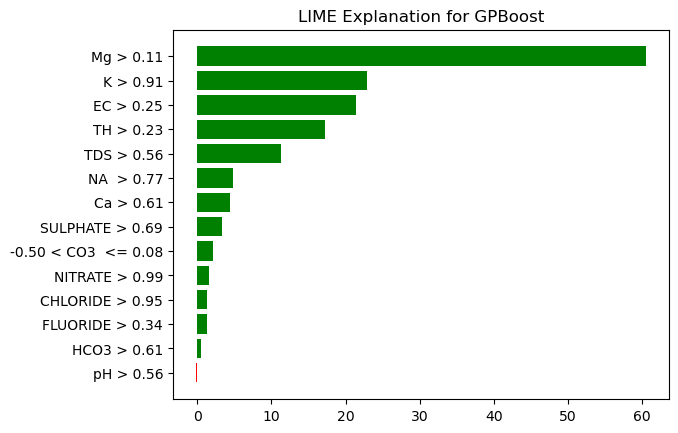

0:	learn: 53.5469187	total: 7.19ms	remaining: 3.59s
1:	learn: 50.8833241	total: 8.12ms	remaining: 2.02s
2:	learn: 49.5479454	total: 8.45ms	remaining: 1.4s
3:	learn: 47.0209822	total: 8.74ms	remaining: 1.08s
4:	learn: 44.3950982	total: 8.99ms	remaining: 890ms
5:	learn: 42.1908399	total: 9.23ms	remaining: 760ms
6:	learn: 39.9137171	total: 9.49ms	remaining: 668ms
7:	learn: 38.0255988	total: 9.83ms	remaining: 605ms
8:	learn: 36.4937022	total: 10.1ms	remaining: 553ms
9:	learn: 34.6983806	total: 10.4ms	remaining: 509ms
10:	learn: 33.3461777	total: 10.7ms	remaining: 473ms
11:	learn: 31.9392819	total: 10.9ms	remaining: 443ms
12:	learn: 30.5283055	total: 11.2ms	remaining: 418ms
13:	learn: 28.6846743	total: 11.4ms	remaining: 396ms
14:	learn: 27.4351348	total: 11.7ms	remaining: 377ms
15:	learn: 26.3056216	total: 11.9ms	remaining: 360ms
16:	learn: 25.3413527	total: 12.2ms	remaining: 347ms
17:	learn: 24.3303027	total: 12.5ms	remaining: 334ms
18:	learn: 23.2638377	total: 12.8ms	remaining: 323ms
19:	

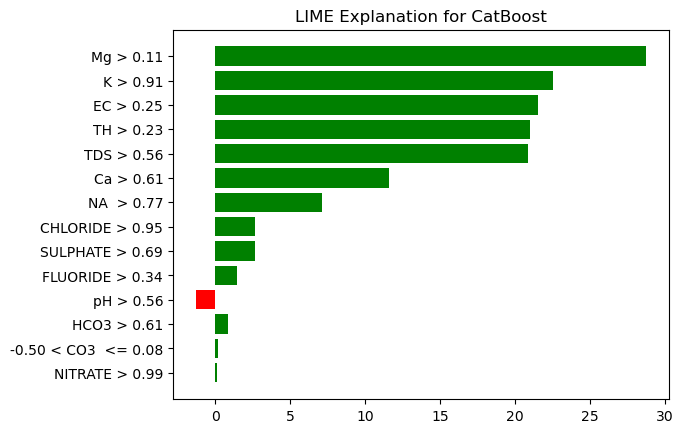


LIME Explanation for instance 5 in SVM:


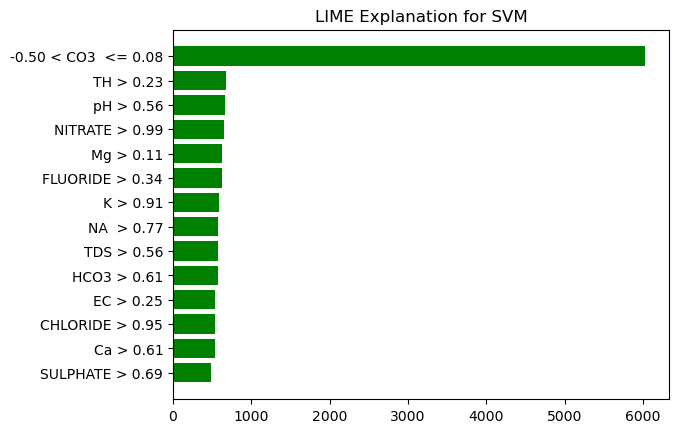

[iter 0] loss=5.2895 val_loss=0.0000 scale=2.0000 norm=74.6289
[iter 100] loss=4.3753 val_loss=0.0000 scale=2.0000 norm=22.4034

LIME Explanation for instance 5 in NGBoost:


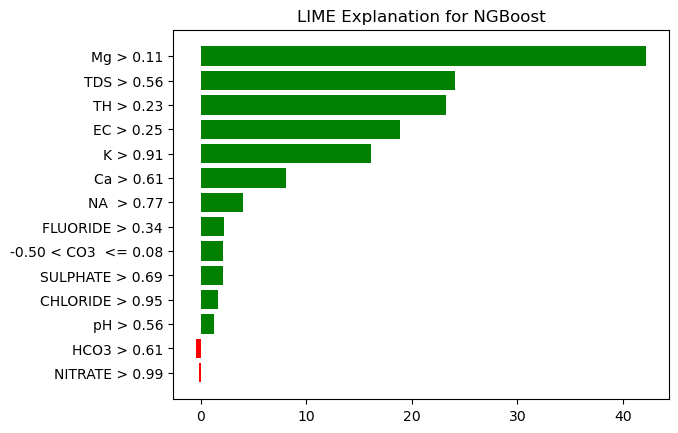

In [31]:
generate_explanations(best_scores_ran, X_train, y_train, x_test, feature_names, method='lime', instance_idx=5)

  0%|          | 0/1 [00:00<?, ?it/s]


SHAP Explanation for instance 5 in Decision Tree:


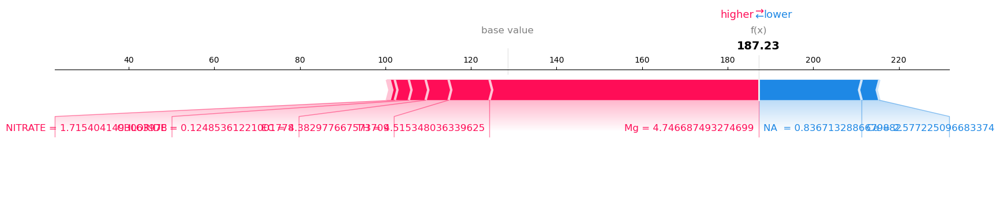

  0%|          | 0/47 [00:00<?, ?it/s]

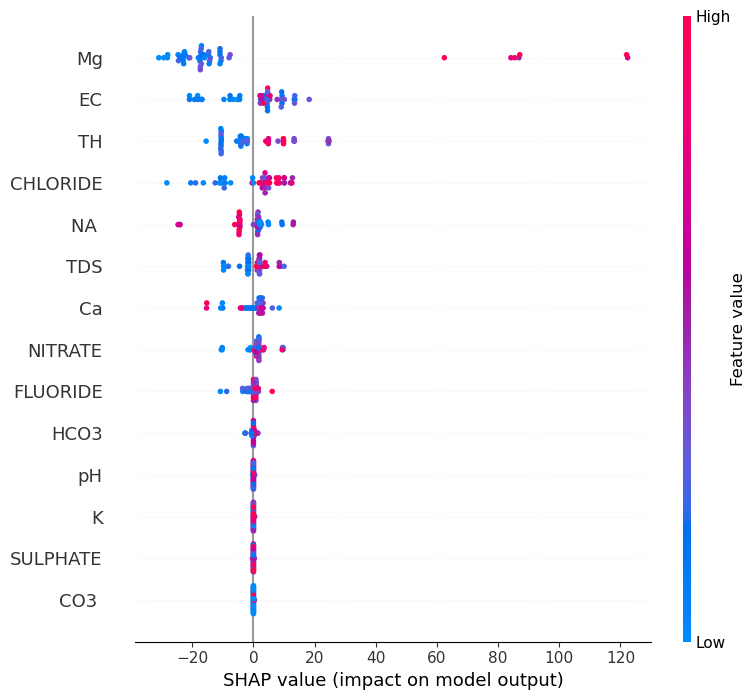

  0%|          | 0/1 [00:00<?, ?it/s]


SHAP Explanation for instance 5 in Random Forest:


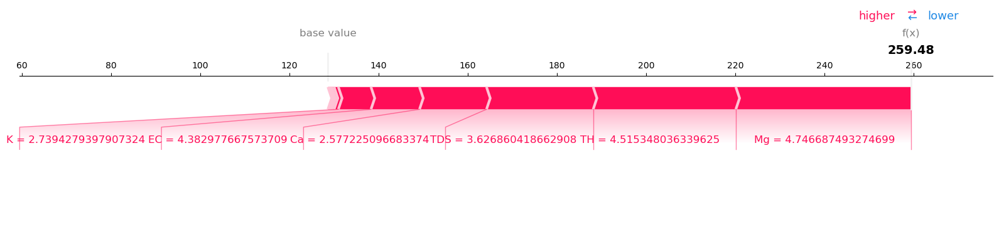

  0%|          | 0/47 [00:00<?, ?it/s]

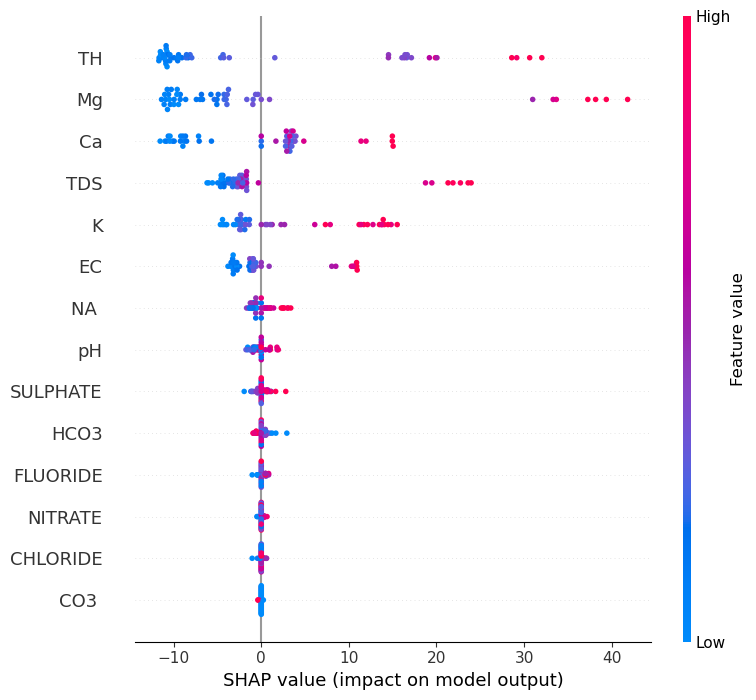

  0%|          | 0/1 [00:00<?, ?it/s]


SHAP Explanation for instance 5 in Gradient Boosting:


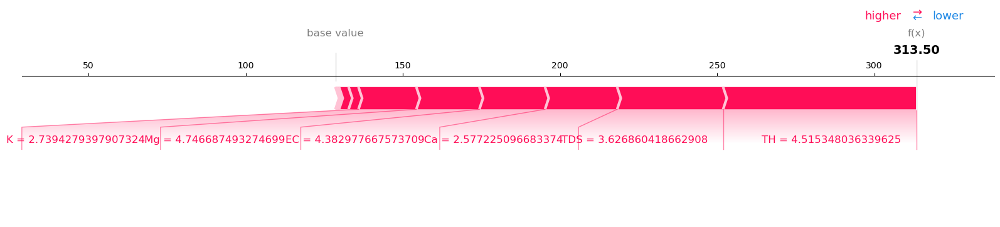

  0%|          | 0/47 [00:00<?, ?it/s]

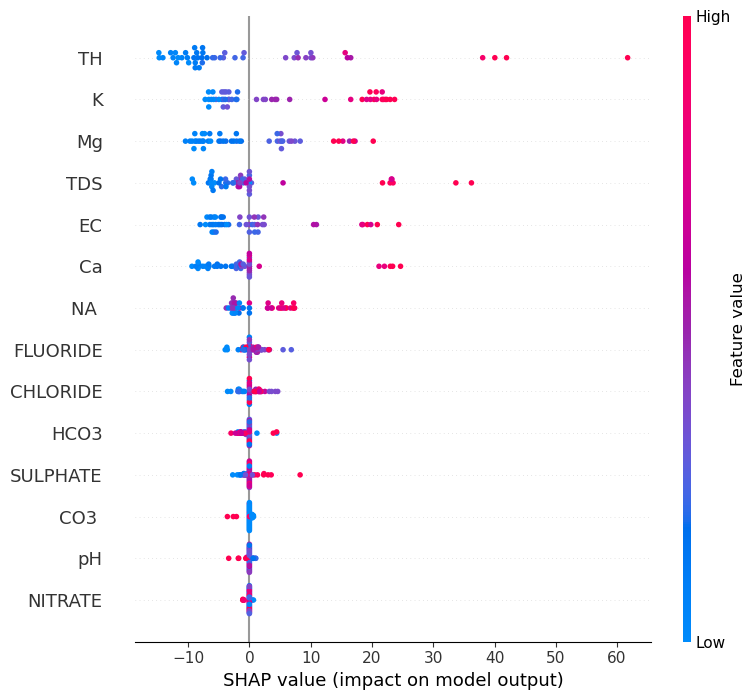


SHAP Explanation for instance 5 in XGBoost:


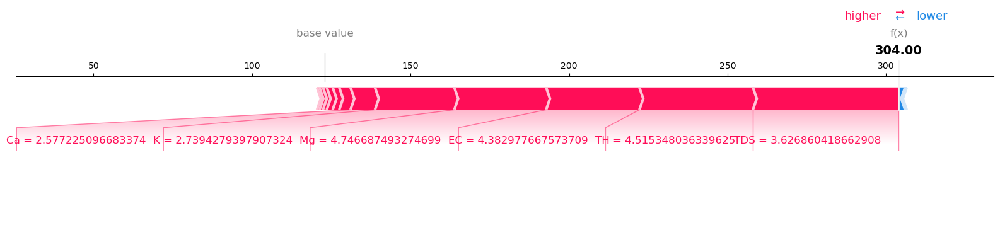

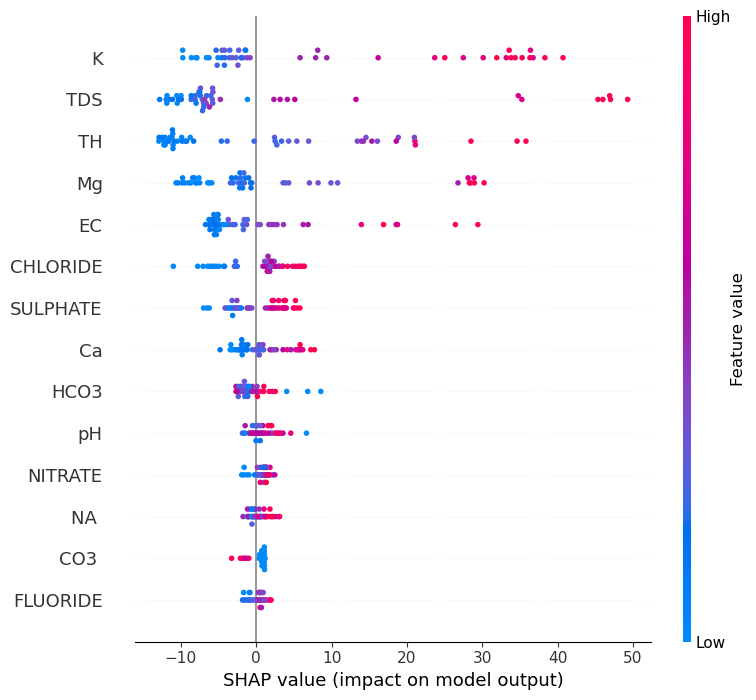

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000039 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 216
[LightGBM] [Info] Number of data points in the train set: 47, number of used features: 14
[LightGBM] [Info] Start training from score 128.566383
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

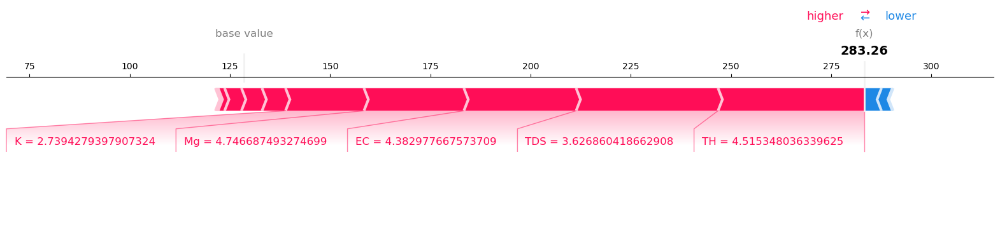

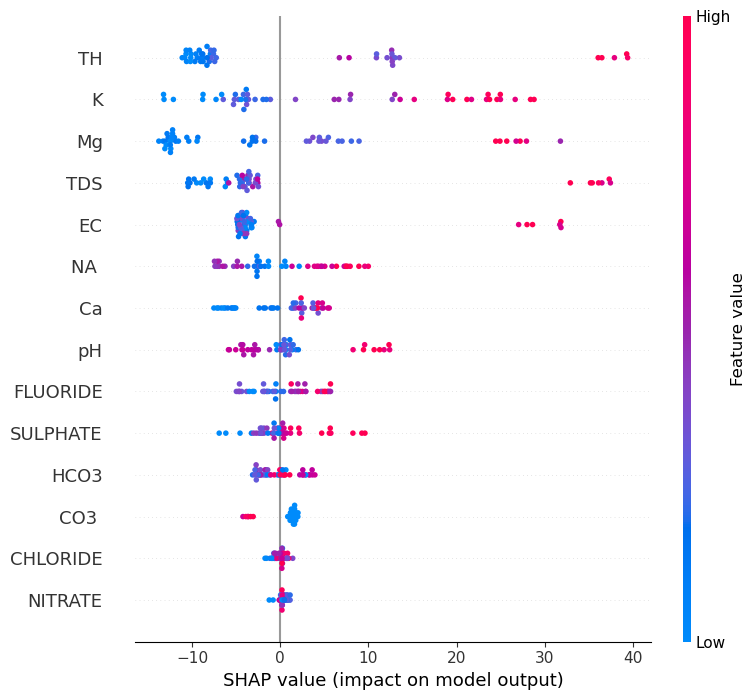

[GPBoost] [Warning] lambda_l2 is set with reg_lambda=0.0, will be overridden by lambda=0.5. Current value: lambda_l2=0.5


  0%|          | 0/1 [00:00<?, ?it/s]


SHAP Explanation for instance 5 in GPBoost:


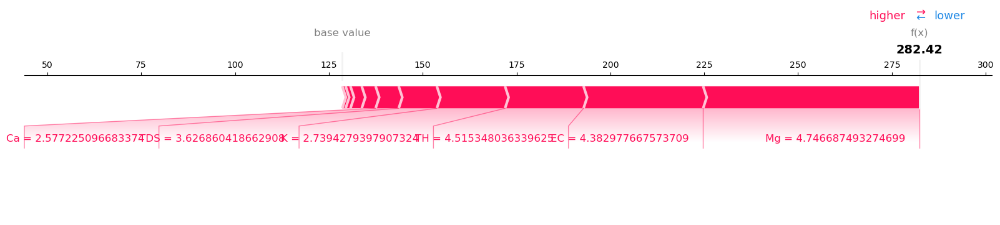

  0%|          | 0/47 [00:00<?, ?it/s]

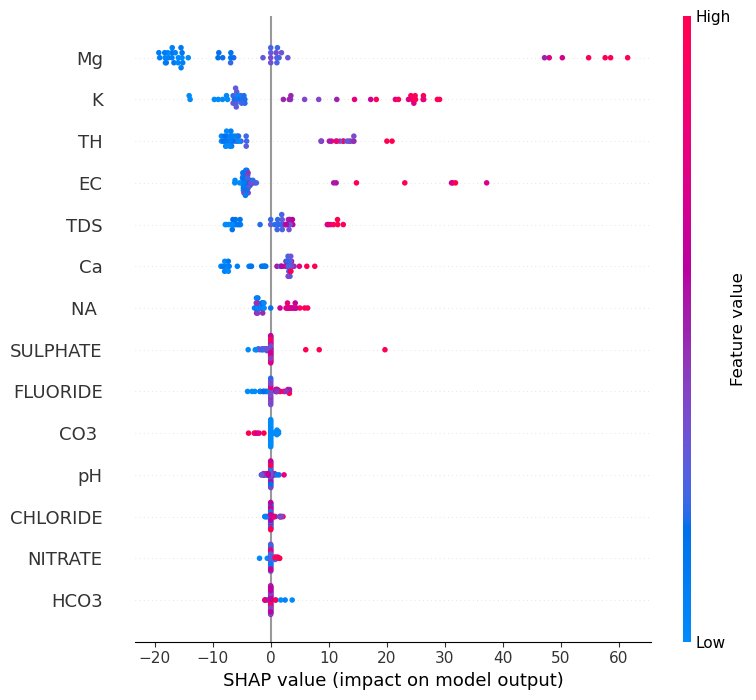

0:	learn: 53.5469187	total: 442us	remaining: 221ms
1:	learn: 50.8833241	total: 1.11ms	remaining: 277ms
2:	learn: 49.5479454	total: 1.36ms	remaining: 225ms
3:	learn: 47.0209822	total: 1.59ms	remaining: 197ms
4:	learn: 44.3950982	total: 1.82ms	remaining: 180ms
5:	learn: 42.1908399	total: 2.06ms	remaining: 169ms
6:	learn: 39.9137171	total: 2.3ms	remaining: 162ms
7:	learn: 38.0255988	total: 2.54ms	remaining: 156ms
8:	learn: 36.4937022	total: 2.78ms	remaining: 151ms
9:	learn: 34.6983806	total: 3ms	remaining: 147ms
10:	learn: 33.3461777	total: 3.22ms	remaining: 143ms
11:	learn: 31.9392819	total: 3.45ms	remaining: 140ms
12:	learn: 30.5283055	total: 3.68ms	remaining: 138ms
13:	learn: 28.6846743	total: 4.01ms	remaining: 139ms
14:	learn: 27.4351348	total: 4.29ms	remaining: 139ms
15:	learn: 26.3056216	total: 4.56ms	remaining: 138ms
16:	learn: 25.3413527	total: 4.96ms	remaining: 141ms
17:	learn: 24.3303027	total: 5.22ms	remaining: 140ms
18:	learn: 23.2638377	total: 5.47ms	remaining: 139ms
19:	lear

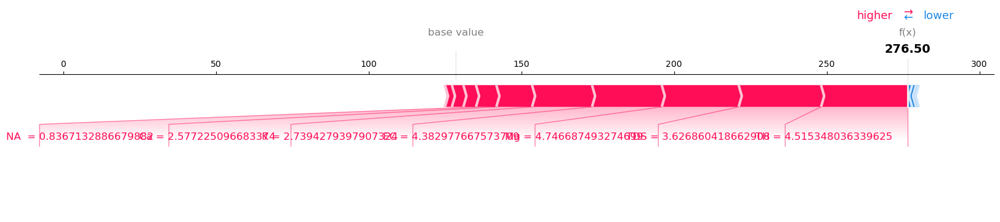

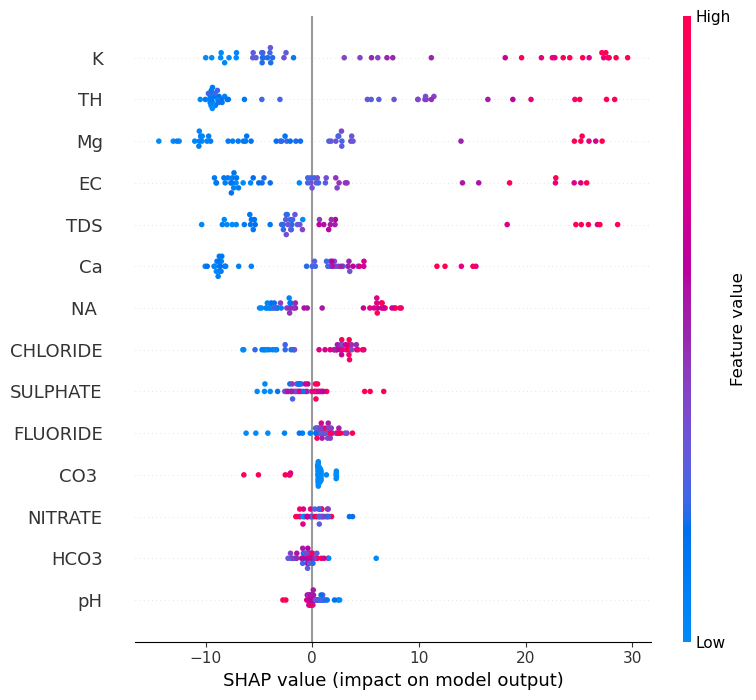

  0%|          | 0/1 [00:00<?, ?it/s]


SHAP Explanation for instance 5 in SVM:


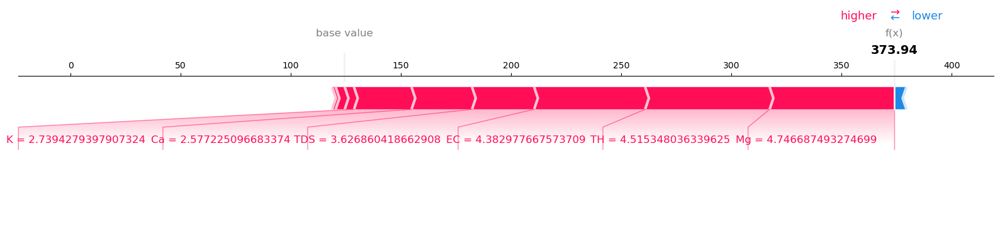

  0%|          | 0/47 [00:00<?, ?it/s]

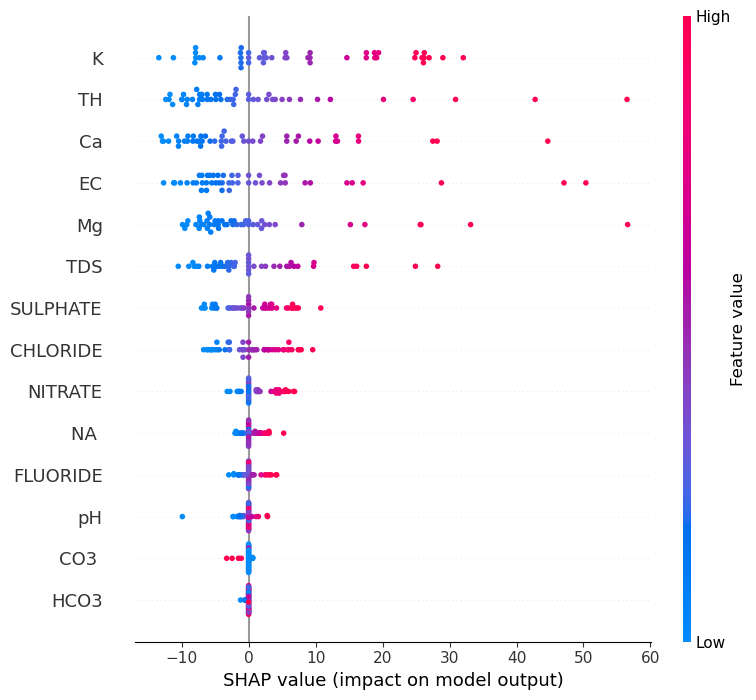

[iter 0] loss=5.4795 val_loss=0.0000 scale=1.0000 norm=41.7762
[iter 100] loss=4.3504 val_loss=0.0000 scale=2.0000 norm=20.4693


  0%|          | 0/1 [00:00<?, ?it/s]


SHAP Explanation for instance 5 in NGBoost:


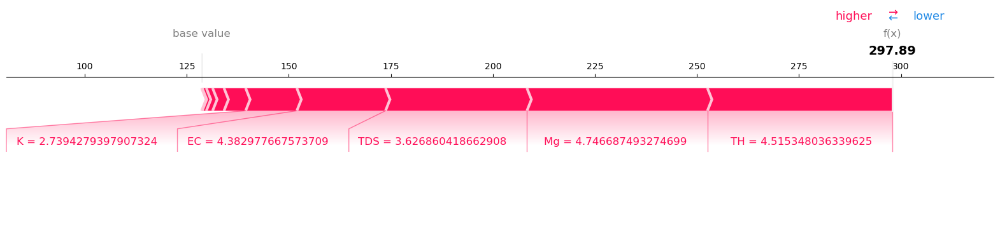

  0%|          | 0/47 [00:00<?, ?it/s]

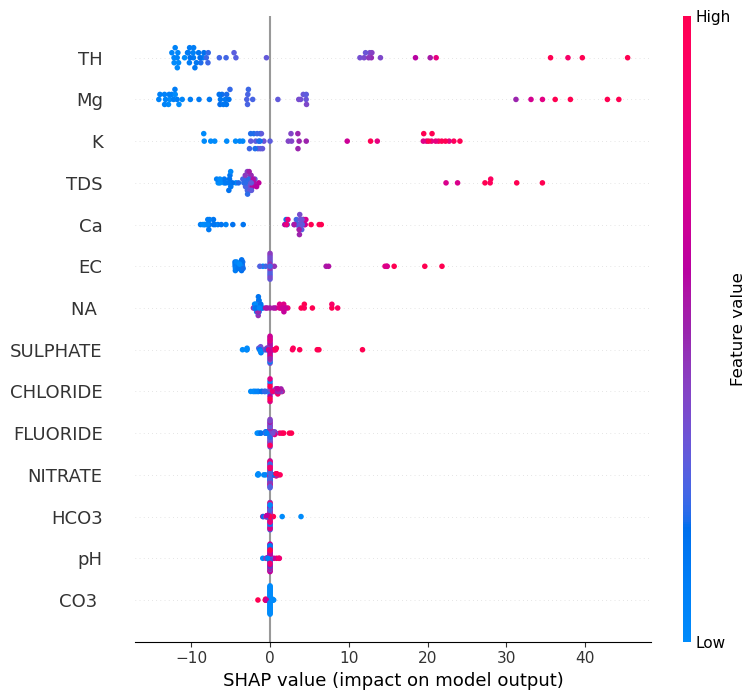

In [33]:
generate_explanations(best_scores_ran, X_train, y_train, X_test, feature_names, instance_idx=5)

<Figure size 1000x600 with 0 Axes>

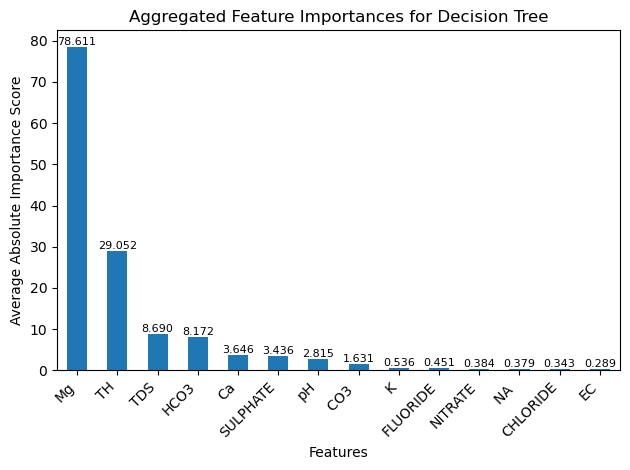

<Figure size 1000x600 with 0 Axes>

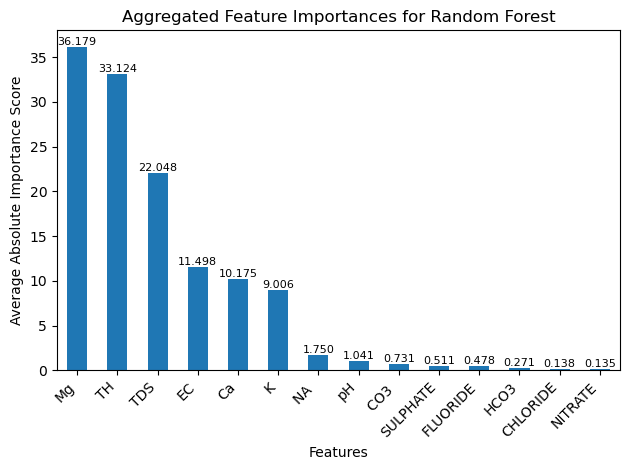

<Figure size 1000x600 with 0 Axes>

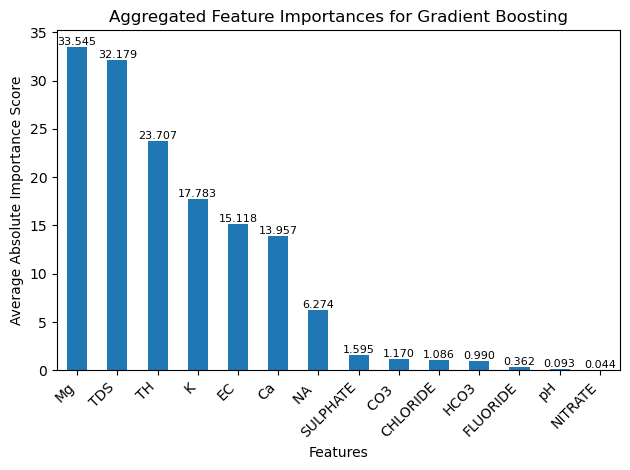

<Figure size 1000x600 with 0 Axes>

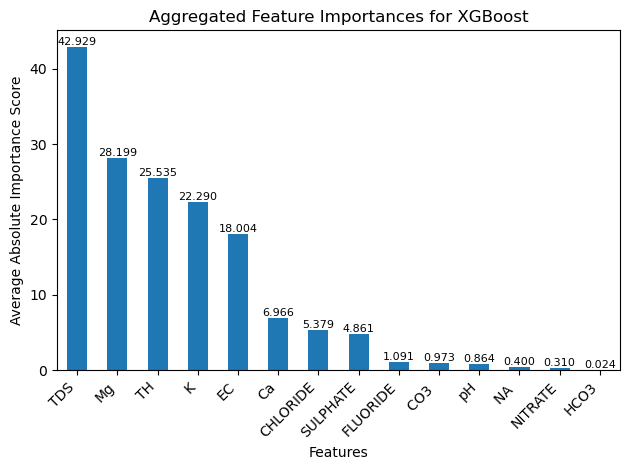

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000042 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 216
[LightGBM] [Info] Number of data points in the train set: 47, number of used features: 14
[LightGBM] [Info] Start training from score 128.566383
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

<Figure size 1000x600 with 0 Axes>

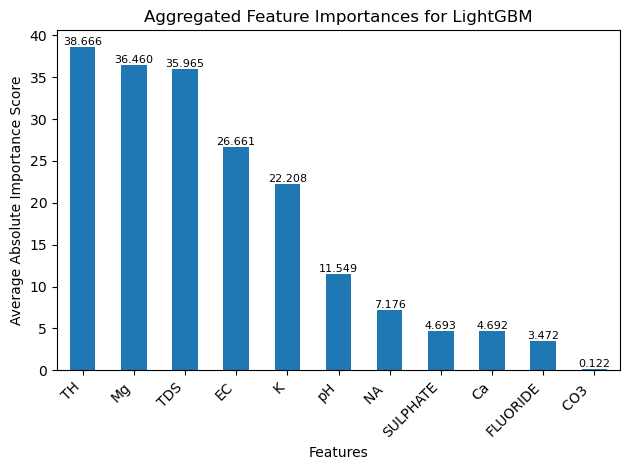

[GPBoost] [Warning] lambda_l2 is set with reg_lambda=0.0, will be overridden by lambda=0.5. Current value: lambda_l2=0.5


<Figure size 1000x600 with 0 Axes>

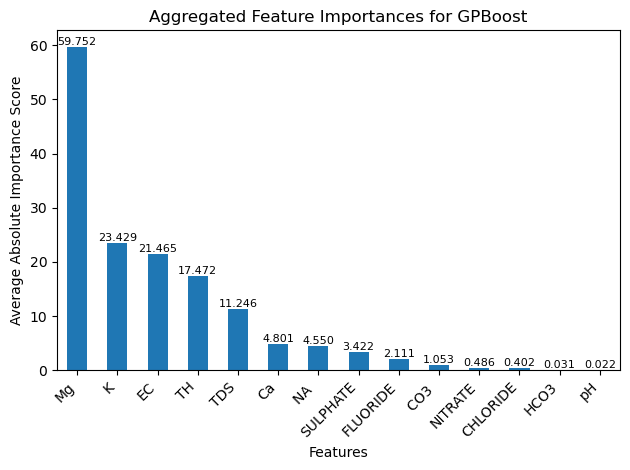

<Figure size 1000x600 with 0 Axes>

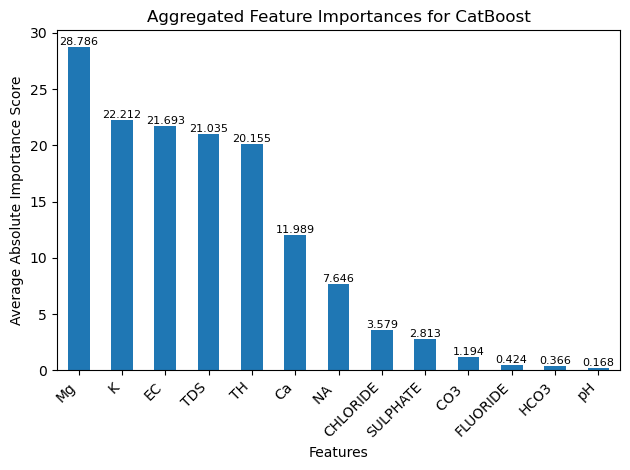

<Figure size 1000x600 with 0 Axes>

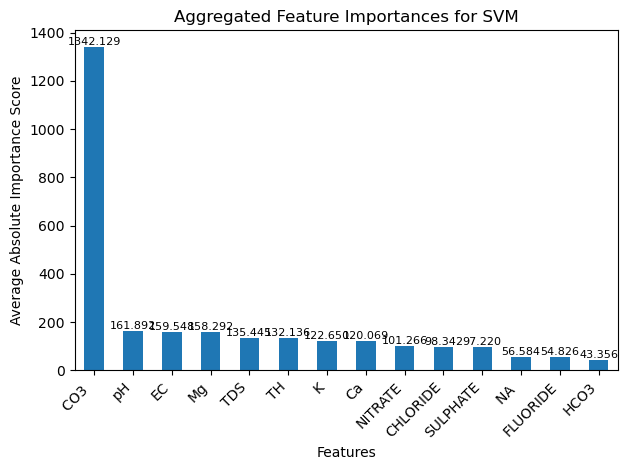

[iter 0] loss=5.3886 val_loss=0.0000 scale=2.0000 norm=80.5795
[iter 100] loss=4.3768 val_loss=0.0000 scale=2.0000 norm=21.7013


<Figure size 1000x600 with 0 Axes>

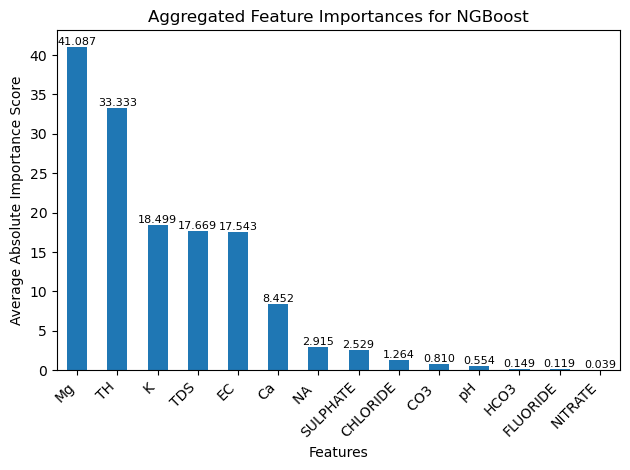

In [34]:
generate_interpretml_explanations_summary(best_scores_ran, X_train, y_train, x_test, feature_names)

In [35]:
generate_interpretml_explanations_all(best_scores_ran, X_train, y_train, x_test, feature_names)

Model: Decision Tree
Explainer: LIME


<!-- http://127.0.0.1:7001/1351379426992/ -->

Model: Random Forest
Explainer: LIME


<!-- http://127.0.0.1:7001/1351308039936/ -->

Model: Gradient Boosting
Explainer: LIME


<!-- http://127.0.0.1:7001/1351350853680/ -->

Model: XGBoost
Explainer: LIME


<!-- http://127.0.0.1:7001/1351351657552/ -->

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000265 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 216
[LightGBM] [Info] Number of data points in the train set: 47, number of used features: 14
[LightGBM] [Info] Start training from score 128.566383
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

<!-- http://127.0.0.1:7001/1351348326608/ -->

[GPBoost] [Warning] lambda_l2 is set with reg_lambda=0.0, will be overridden by lambda=0.5. Current value: lambda_l2=0.5
Model: GPBoost
Explainer: LIME


<!-- http://127.0.0.1:7001/1351349026016/ -->

Model: CatBoost
Explainer: LIME


<!-- http://127.0.0.1:7001/1351361874976/ -->

Model: SVM
Explainer: LIME


<!-- http://127.0.0.1:7001/1351345260304/ -->

[iter 0] loss=5.4371 val_loss=0.0000 scale=1.0000 norm=39.3516
[iter 100] loss=4.2946 val_loss=0.0000 scale=2.0000 norm=17.0818
Model: NGBoost
Explainer: LIME


<!-- http://127.0.0.1:7001/1351360636656/ -->